<a href="https://colab.research.google.com/github/Dita15/Masker-Deteksi/blob/main/mask_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.6.0+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15079MB, multi_processor_count=40)


In [ ]:
%cd /content
!curl -L "https://public.roboflow.com/ds/fztVqpoB1j?key=pf5uuCktTm" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1033      0 --:--:-- --:--:-- --:--:--  1032
100 18.5M  100 18.5M    0     0  12.3M      0  0:00:01  0:00:01 --:--:-- 12.3M
Archive:  roboflow.zip
 extracting: test/images/1288126-10255706714jpg_jpg.rf.ed230c79fdbb1fa0650ff4fd32f620ee.jpg  
 extracting: test/images/shutterstock_1627199179_jpg.rf.350e69105dd1458572a590c3e3ef2538.jpg  
 extracting: test/images/15391513324714o1n0r10n6_jpg.rf.eb6b6b796ad74b0c9d75011d1020f0af.jpg  
 extracting: train/images/1125506397_15801322206131n_jpg.rf.0a60284a71b2d0ed77c002e768b39b00.jpg  
 extracting: test/images/1579924271_jpg.rf.1fea0f43731fbea2876f63135256004f.jpg  
 extracting: train/images/1_R_kFK9pNLfKAuopY_lAaPQ_jpeg.rf.030922effaedbead963acea666441dbd.jpg  
 extracting: test/images/1224331650_g_400-w_g_jpg.rf.483a35a2395bf48e96783587a59fe876.jpg

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 2
names: ['mask', 'no-mask']

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))


In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', epochs=100, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2020-09-27 15:43:59.068430: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'warmup_bias_lr': 0.1, 'giou': 0.05, 'cls': 0.5, 'cls_p

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

/content/yolov5/runs/exp0_yolov5s_results


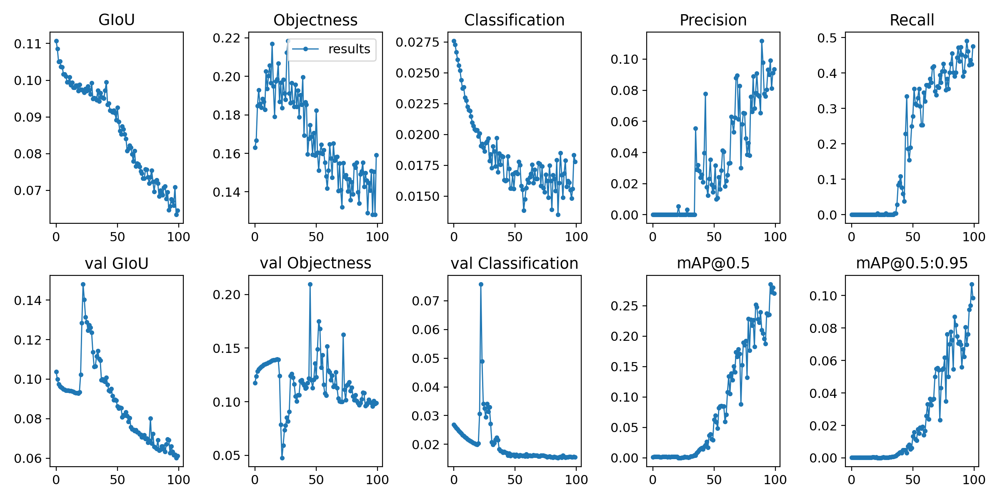

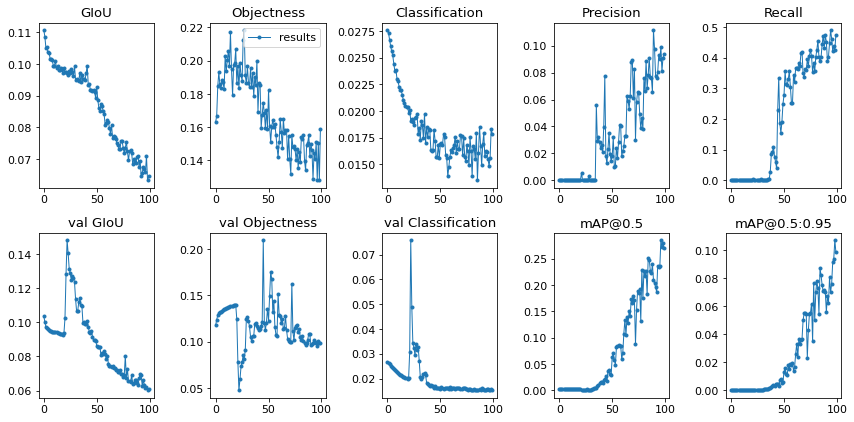

In [ ]:
%cd /content/yolov5/runs/exp0_yolov5s_results/

# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.general import plot_results; plot_results()  # plot results.txt as results.png
Image(filename='./results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


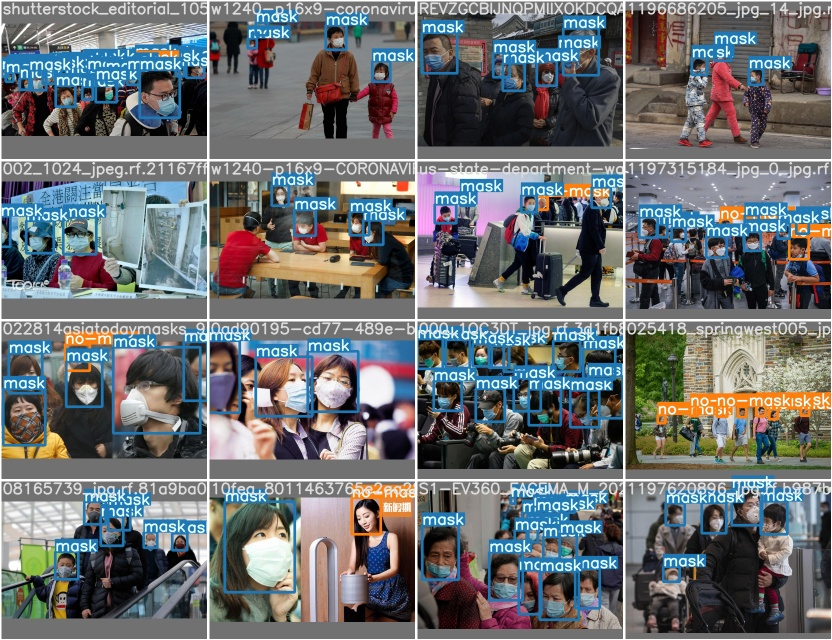

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='./test_batch0_gt.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


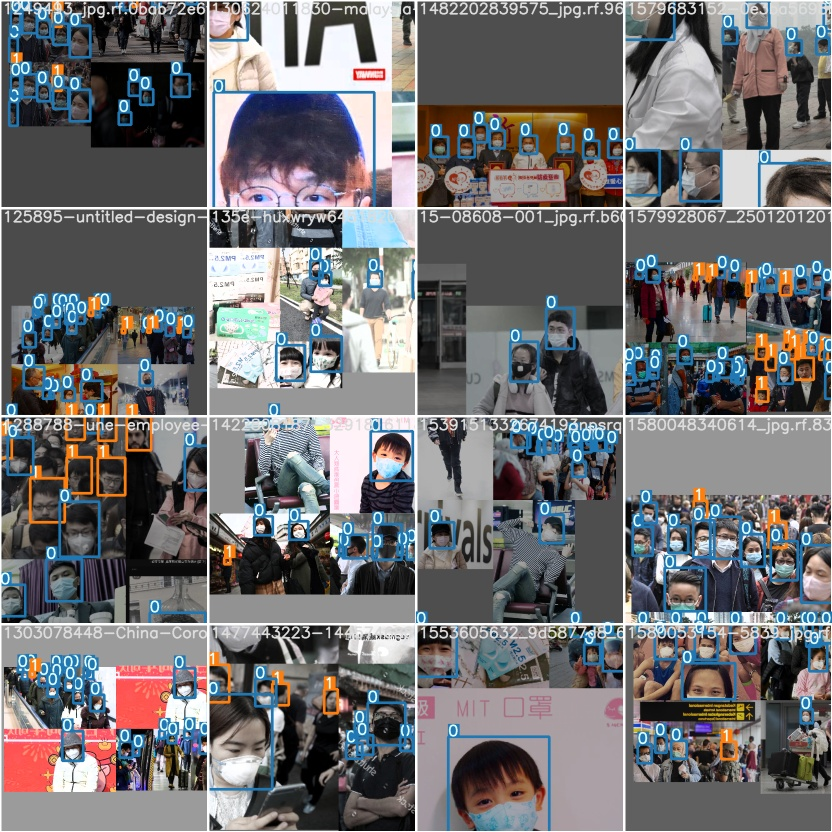

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='./train_batch2.jpg', width=900)

In [ ]:
# trained weights are saved by default in our weights folder
%cd /content/yolov5/
%ls runs/

/content/yolov5
exp0_yolov5s_results/


In [ ]:
%ls runs/exp0_yolov5s_results/weights

best.pt  last.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/exp0_yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/exp0_yolov5s_results/weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... 
Model Summary: 191 layers, 7.25779e+06 parameters, 0 gradients
image 1/15 /content/test/images/0_Concern-In-China-As-Mystery-Virus-Spreads_jpg.rf.5633f5fe7a9b926101b7fc16615dfb6a.jpg: 224x416 1 masks, Done. (0.012s)
image 2/15 /content/test/images/1224331650_g_400-w_g_jpg.rf.483a35a2395bf48e96783587a59fe876.jpg: 416x416 2 masks, Done. (0.011s)
image 3/15 /content/test/images/126202-untitled-design-13_jpg.rf.baa3d2e55d469ae5d5d4cd81c4603e1d.jpg: 288x416 6 masks, Done. (0.012s)
image 4/15 /content/test/images/1288126-10255706714jpg_jpg.rf.ed230c79fdbb1fa0650ff4fd32f620ee.jpg: 288x416 1 masks, Done. (0.011s)
imag

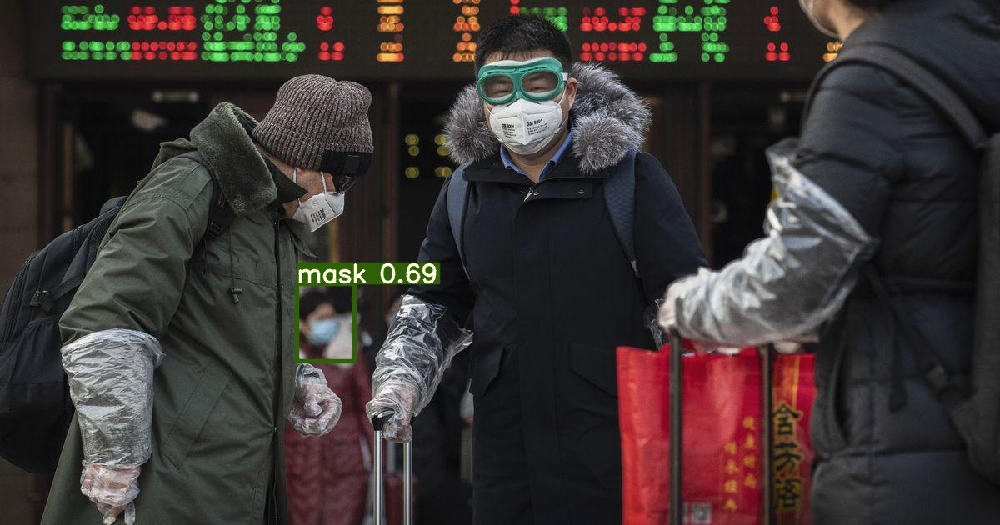

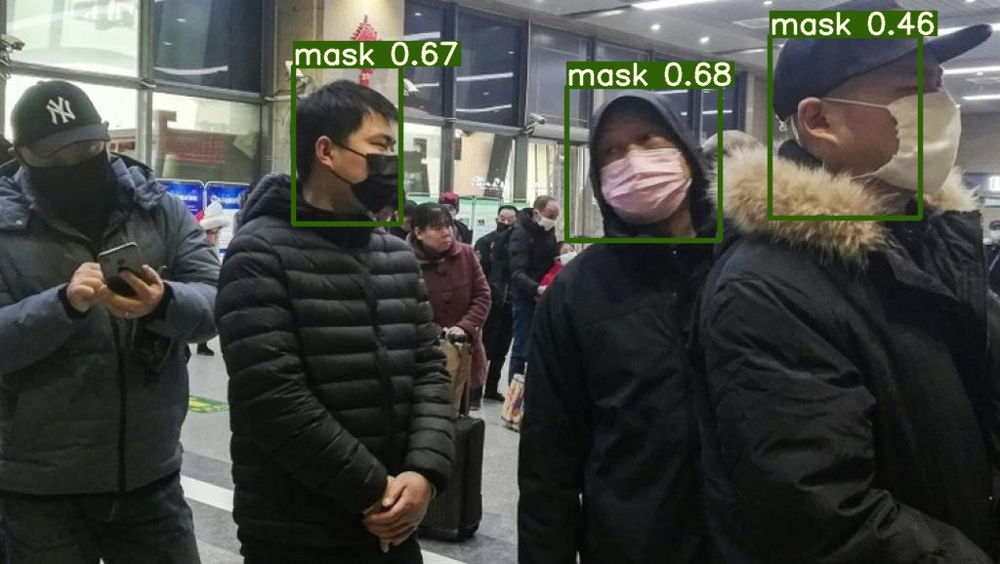

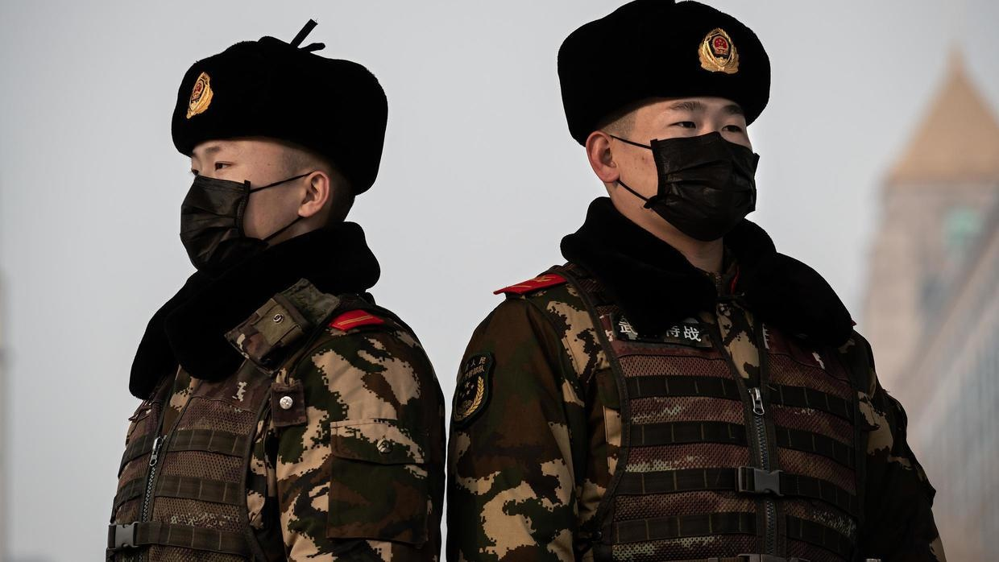

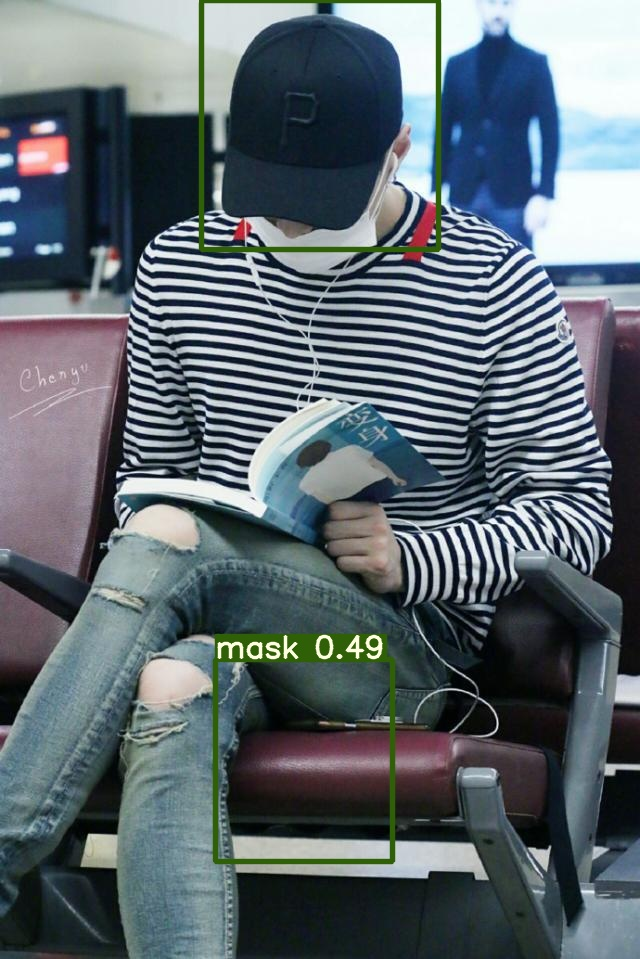

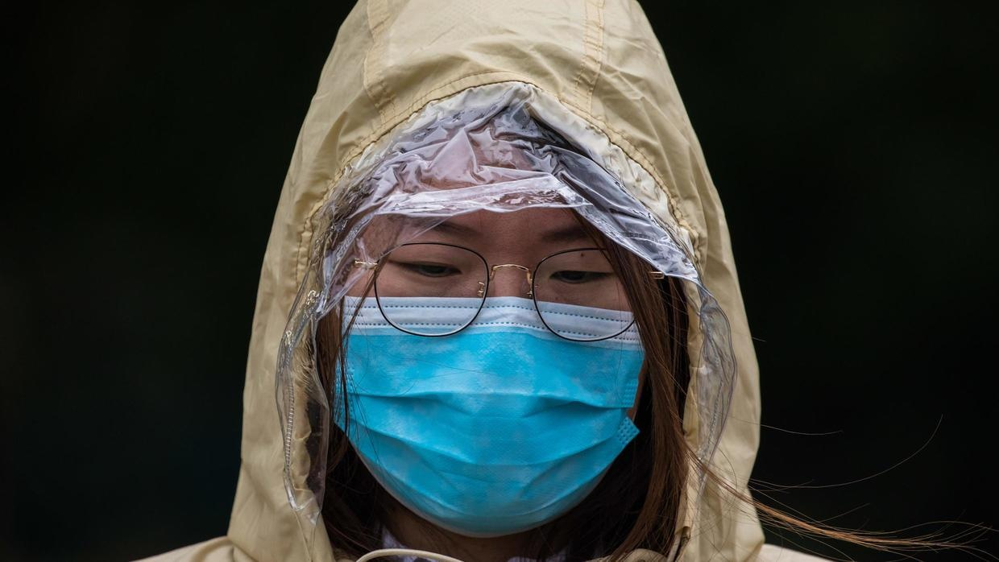

...

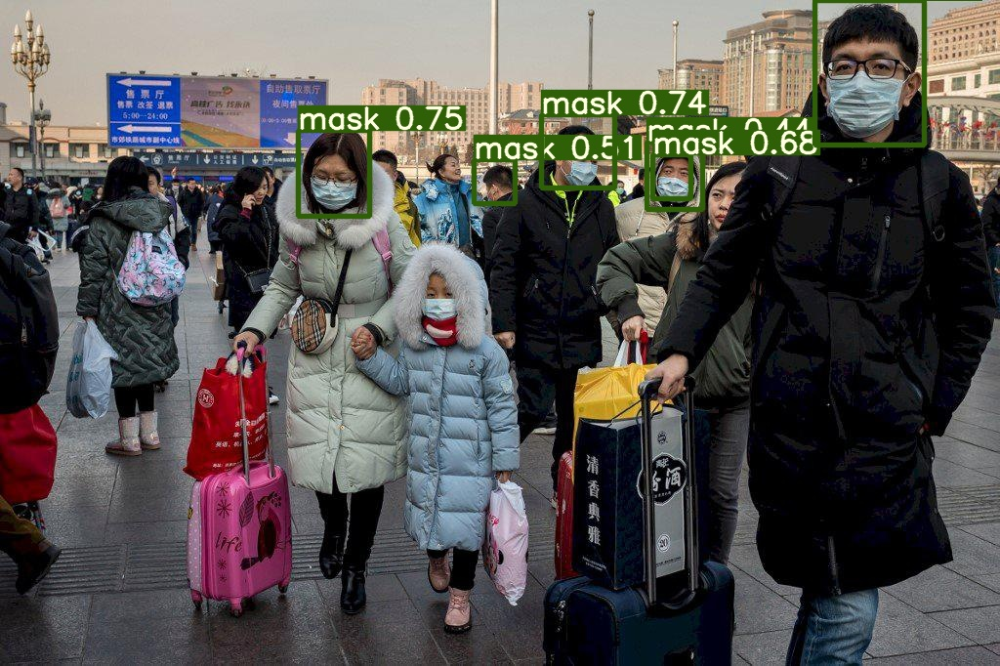

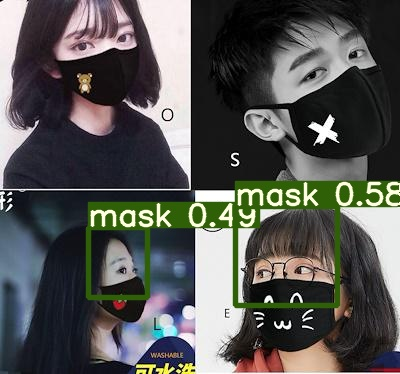

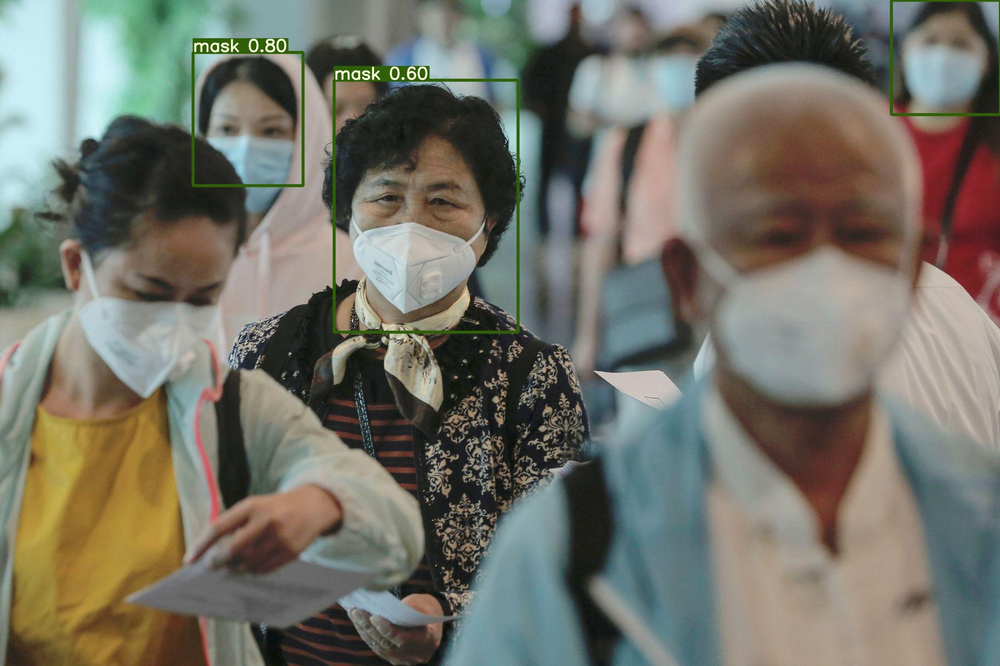

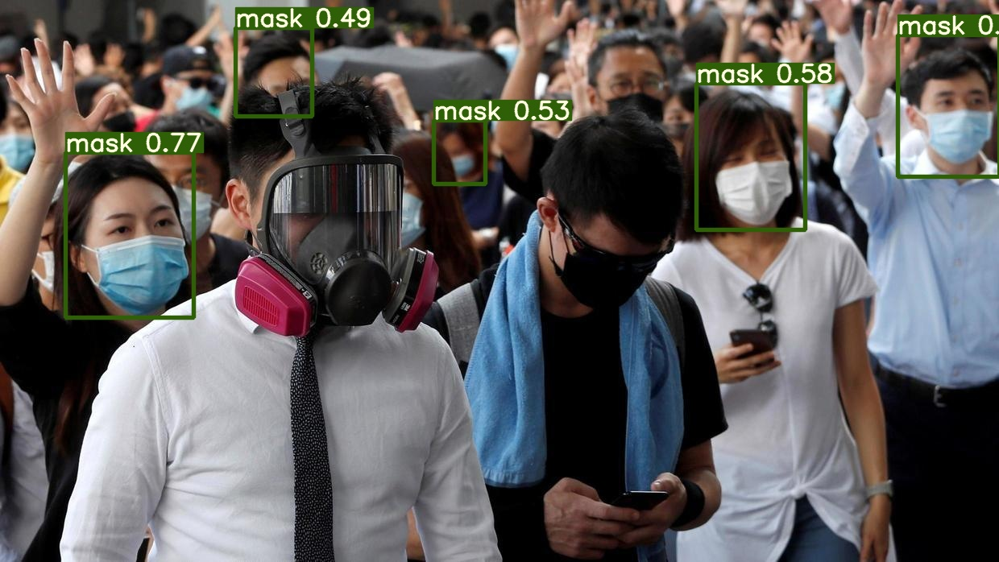

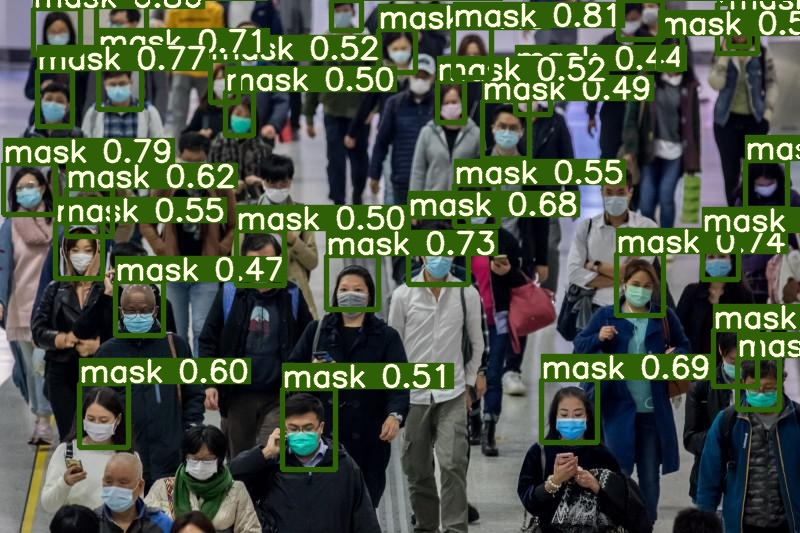

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.6.0+cu101 _CudaDeviceProperties(name='Tesla P4', major=6, minor=1, total_memory=7611MB, multi_processor_count=20)


Mencoba best.pt menggunakan data test images dari robotflow

In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights /content/gdrive/My\ Drive/best.pt --img 416 --conf 0.4 --source /content/gdrive/My\ Drive/YoloV5/test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/gdrive/My Drive/YoloV5/test/images', update=False, view_img=False, weights=['/content/gdrive/My Drive/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla K80', total_memory=11441MB)

Fusing layers... 
Model Summary: 191 layers, 7.25779e+06 parameters, 0 gradients
image 1/15 /content/gdrive/My Drive/YoloV5/test/images/0_Concern-In-China-As-Mystery-Virus-Spreads_jpg.rf.5633f5fe7a9b926101b7fc16615dfb6a.jpg: 224x416 1 masks, Done. (0.023s)
image 2/15 /content/gdrive/My Drive/YoloV5/test/images/1224331650_g_400-w_g_jpg.rf.483a35a2395bf48e96783587a59fe876.jpg: 416x416 2 masks, Done. (0.026s)
image 3/15 /content/gdrive/My Drive/YoloV5/test/images/126202-untitled-design-13_jpg.rf.baa3d2e55d469ae5d5d4cd81c4603e1d.jpg: 288x416 6 masks, Done. (0.023s)
image 4/15 /content/gdrive/My Drive/YoloV5/tes

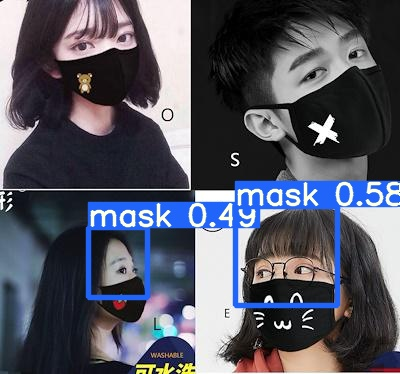

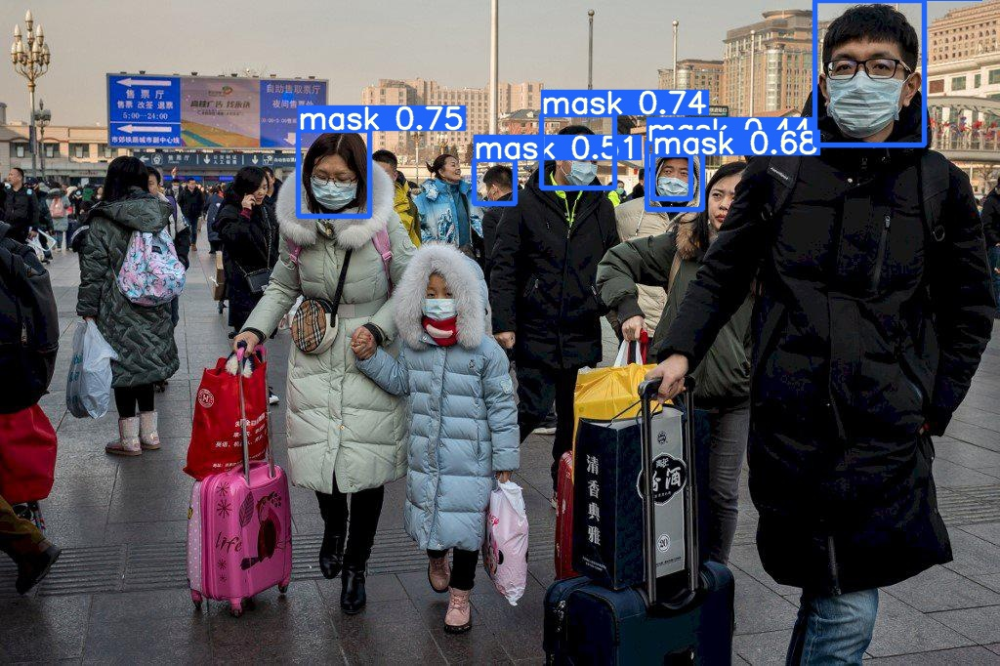

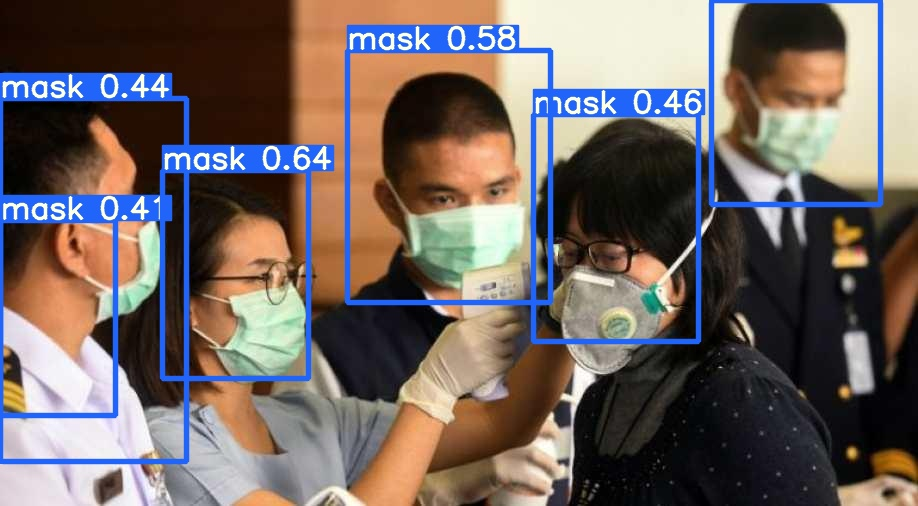

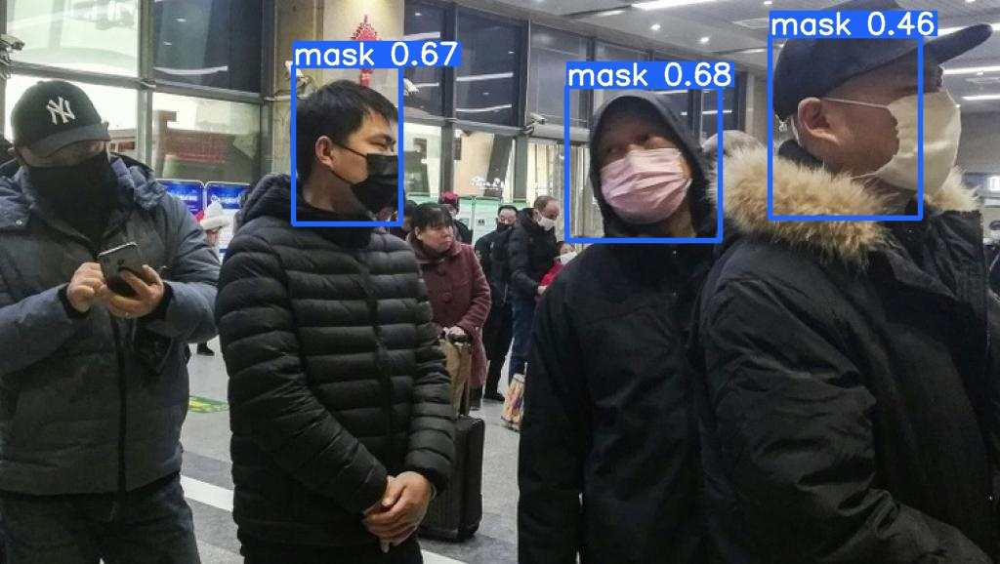

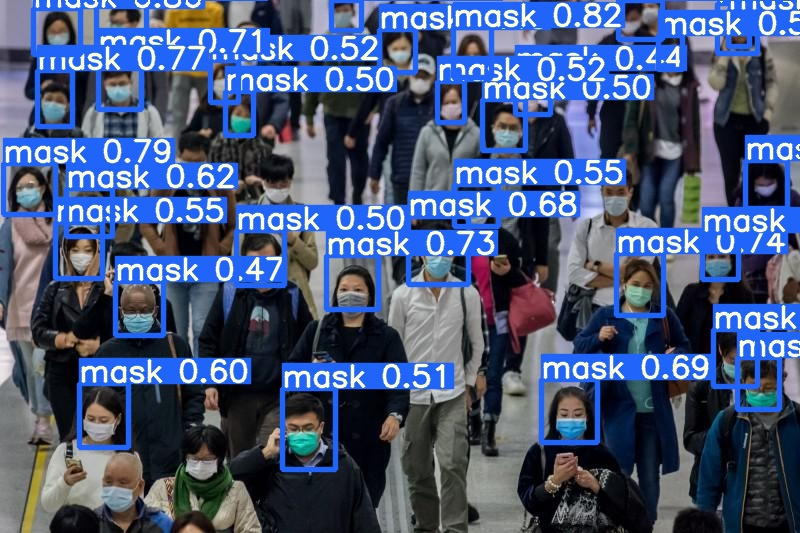

...

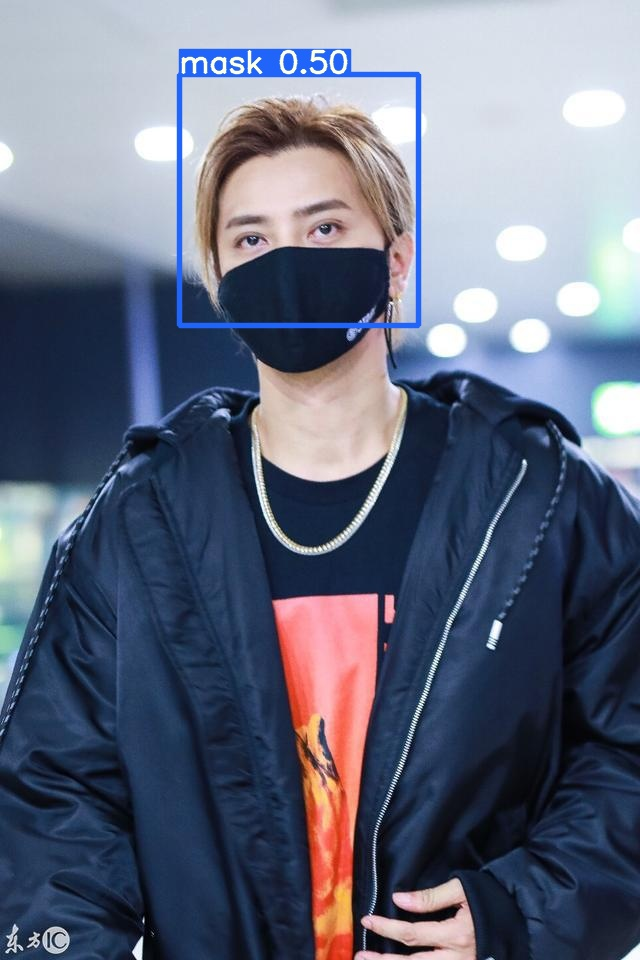

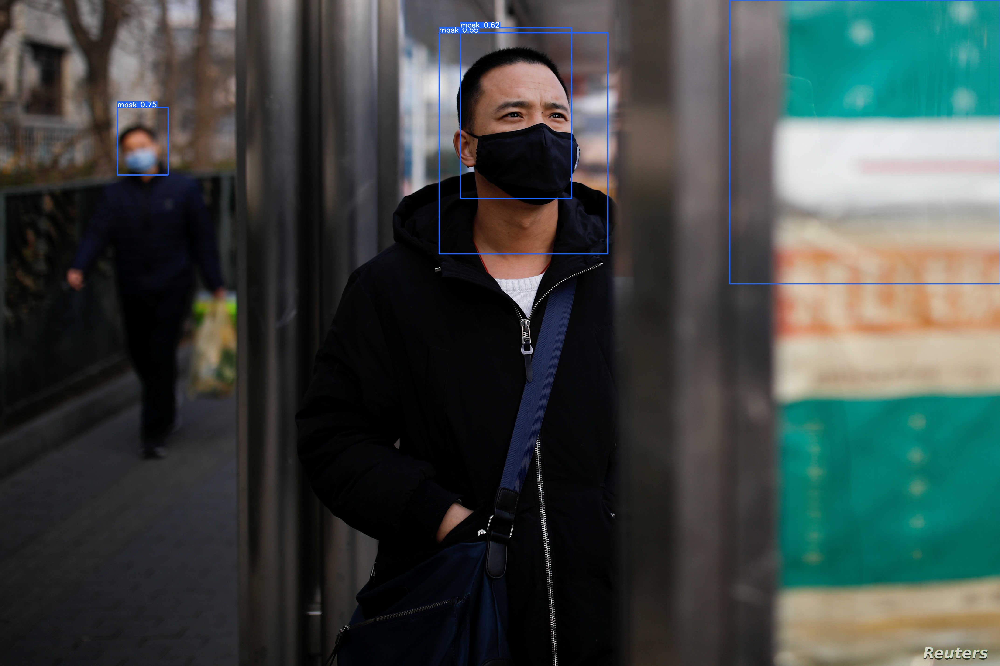

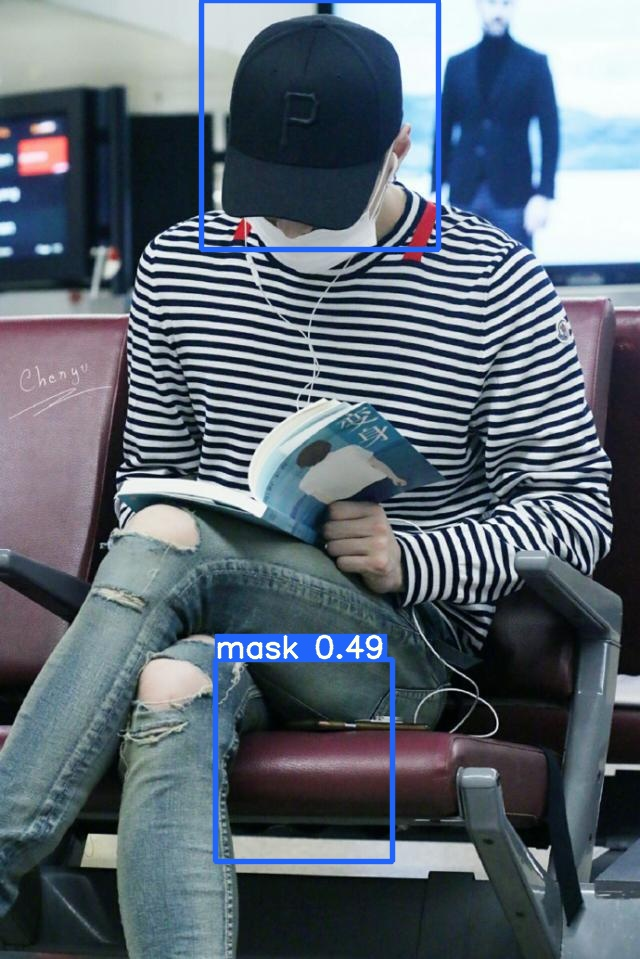

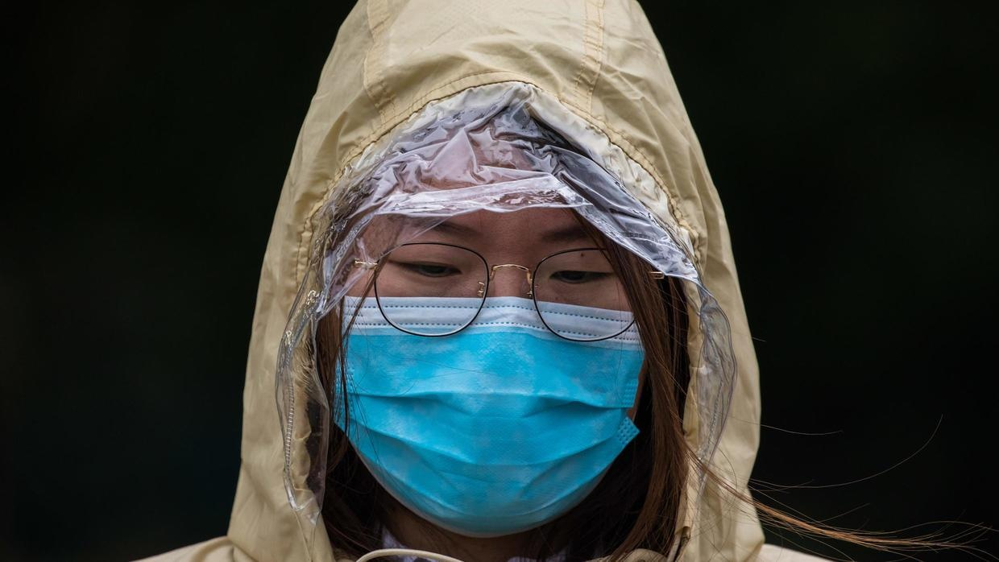

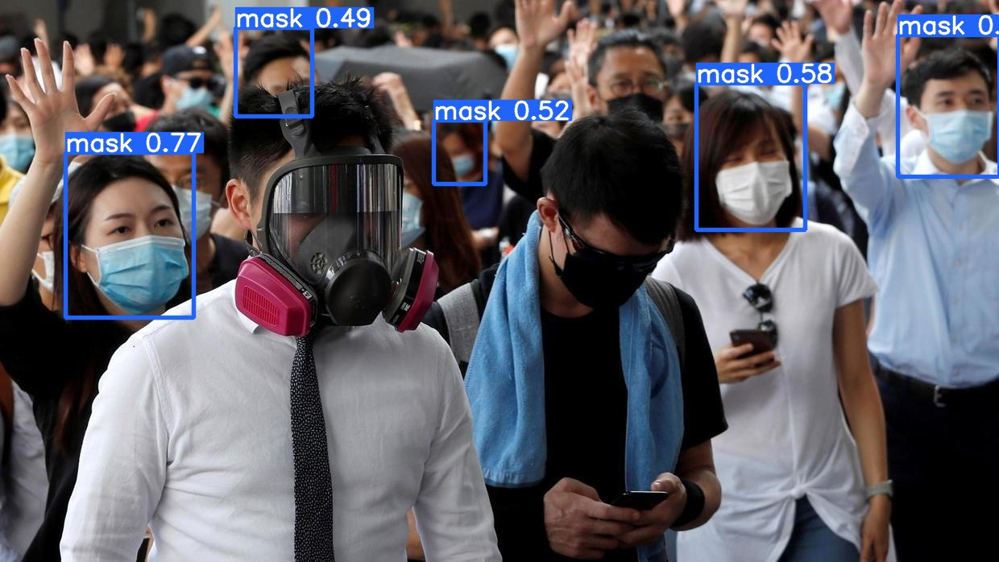

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

mencoba model weight best.pt menggunakan data dari internet dalam folder coba

In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights /content/gdrive/My\ Drive/best.pt --img 416 --conf 0.4 --source /content/gdrive/My\ Drive/YoloV5/coba

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/gdrive/My Drive/YoloV5/coba', update=False, view_img=False, weights=['/content/gdrive/My Drive/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P4', total_memory=7611MB)

Fusing layers... 
Model Summary: 191 layers, 7.25779e+06 parameters, 0 gradients
image 1/10 /content/gdrive/My Drive/YoloV5/coba/masker1.jpg: 224x416 1 masks, Done. (0.017s)
image 2/10 /content/gdrive/My Drive/YoloV5/coba/masker10.jpg: 288x416 5 masks, Done. (0.017s)
image 3/10 /content/gdrive/My Drive/YoloV5/coba/masker2.jpg: 288x416 1 masks, Done. (0.016s)
image 4/10 /content/gdrive/My Drive/YoloV5/coba/masker3.jpg: 288x416 1 masks, Done. (0.016s)
image 5/10 /content/gdrive/My Drive/YoloV5/coba/masker4.jpg: 224x416 1 masks, Done. (0.016s)
image 6/10 /content/gdrive/My Drive/YoloV5/coba/masker5.jpg: 288x416 Done. (

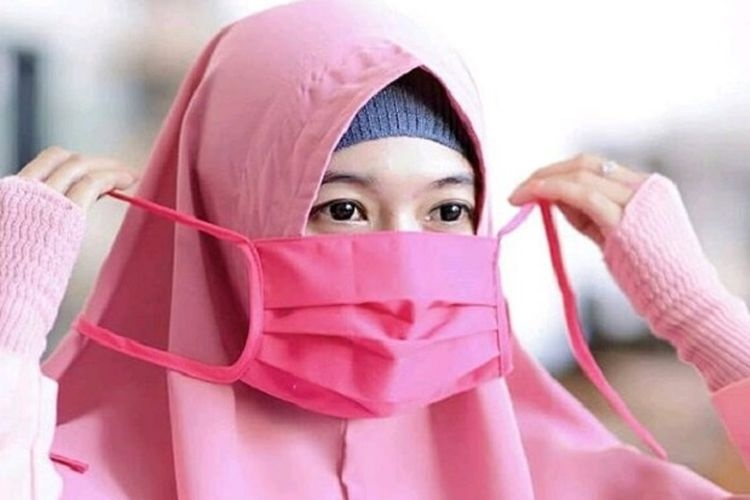

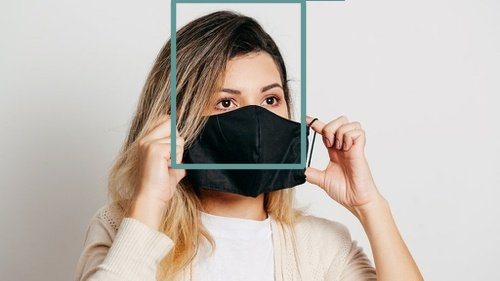

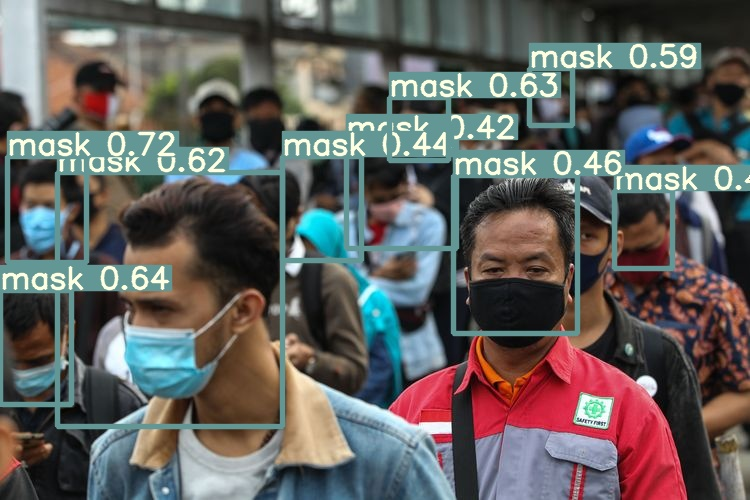

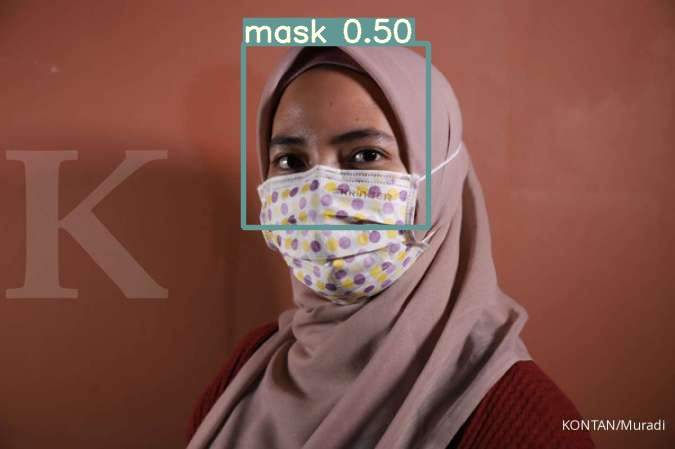

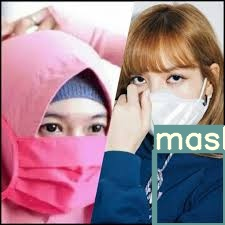

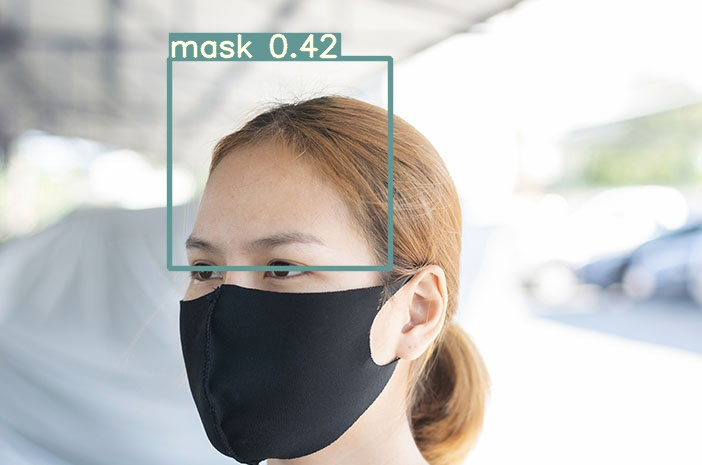

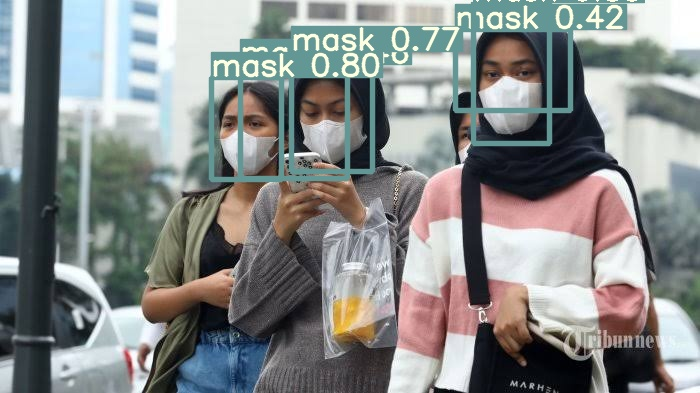

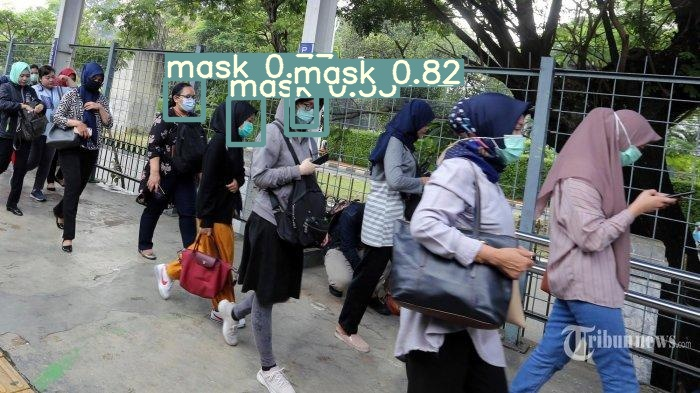

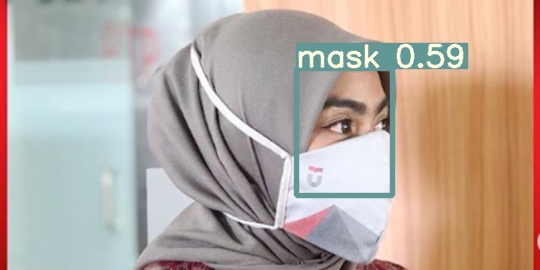

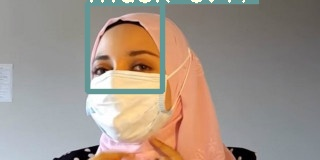

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

camera capture

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function captureFrame(detectValue, videoTag, imageTag, qualityValue){
      if (detectValue) {
        canvas = document.createElement('canvas');
        canvas.width = videoTag.videoWidth;
        canvas.height = videoTag.videoHeight;
        canvas.getContext('2d').drawImage(videoTag, 0, 0);
        picx = canvas.toDataURL('image/jpeg', qualityValue);
        imageTag.setAttribute("src", picx);
        captureFrame(videoTag,imageTag,qualityValue);
      }
      return picx;
    }

    async function takePhoto(quality) {
      const div = document.createElement('div');

      // Stop button
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      // HTML5 video stream
      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});
      video.srcObject = stream;
      await video.play();
      document.body.appendChild(div);
      div.appendChild(video);

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Stop to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);
      
      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      pic = canvas.toDataURL('image/jpeg', quality);

      // stop video stream
      stream.getVideoTracks()[0].stop();
      div.remove();

      return pic;
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg
/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/gdrive/My Drive/YoloV5/photo.jpg', update=False, view_img=False, weights=['/content/gdrive/My Drive/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P4', total_memory=7611MB)

Fusing layers... 
Model Summary: 191 layers, 7.25779e+06 parameters, 0 gradients
image 1/1 /content/gdrive/My Drive/YoloV5/photo.jpg: 512x640 4 masks, Done. (0.027s)
Results saved to inference/output
Done. (0.075s)


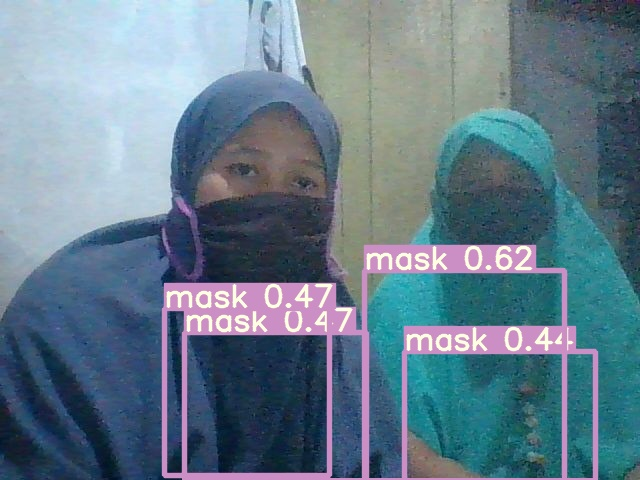

In [ ]:
# For camera
from IPython.display import Image
try:
  picture = take_photo()
  print('Saved to {}'.format(picture))

  %cp photo.jpg /content/gdrive/My\ Drive/YoloV5/photo.jpg
  
  # Classify image
  %cd /content/yolov5/
  !python detect.py --weights /content/gdrive/My\ Drive/best.pt --conf 0.4 --source /content/gdrive/My\ Drive/YoloV5/photo.jpg
  
  #display inference on ALL test images
  import glob
  from IPython.display import Image, display

  for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
      display(Image(filename=imageName))

except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

# New Section

video capture

In [ ]:
from IPython.display import HTML, Javascript, display
from google.colab.output import eval_js
from base64 import b64decode
import numpy as np
import io
import ffmpeg

video_file_test = '/content/gdrive/My Drive/YoloV5/video/test.mp4' 
  

VIDEO_HTML = """
<script>
var my_div = document.createElement("DIV");
var my_p = document.createElement("P");
var my_btn = document.createElement("BUTTON");
var my_btn_txt = document.createTextNode("Press to start recording");

my_btn.appendChild(my_btn_txt);
my_div.appendChild(my_btn);
document.body.appendChild(my_div);

var base64data = 0;
var reader;
var recorder, videoStream;
var recordButton = my_btn;

var handleSuccess = function(stream) {
  videoStream = stream;
  var options = {  
    mimeType : 'video/webm;codecs=vp9'  
  };            
  recorder = new MediaRecorder(stream, options);
  recorder.ondataavailable = function(e) {            
    var url = URL.createObjectURL(e.data);
    var preview = document.createElement('video');
    preview.controls = true;
    preview.src = url;
    document.body.appendChild(preview);

    reader = new FileReader();
    reader.readAsDataURL(e.data); 
    reader.onloadend = function() {
      base64data = reader.result;
    }
  };
  recorder.start();
  };

recordButton.innerText = "Recording... press to stop";

navigator.mediaDevices.getUserMedia({video: true}).then(handleSuccess);


function toggleRecording() {
  if (recorder && recorder.state == "recording") {
      recorder.stop();
      videoStream.getVideoTracks()[0].stop();
      recordButton.innerText = "Saving the recording... Please wait!"
  }
}

function sleep(ms) {
  return new Promise(resolve => setTimeout(resolve, ms));
}

var data = new Promise(resolve=>{
recordButton.onclick = ()=>{
toggleRecording()

sleep(2000).then(() => {
  // wait 2000ms for the data to be available
  resolve(base64data.toString())

});

}
});
      
</script>
"""

def start_webcam():
  js = Javascript('''
    async function startWebcam() {
      const div = document.createElement('div');

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);
      
      return;

    }
    ''')
  
  display(js)
  data = eval_js('startWebcam()')
  
    
start_webcam()

def get_video():
  display(HTML(VIDEO_HTML))
  data = eval_js("data")
  binary = b64decode(data.split(',')[1])
  
  return binary

videofile = get_video()
with open(video_file_test, 'wb') as f:
  f.write(videofile)

ModuleNotFoundError: ignored

In [ ]:
%cd /content/yolov5
!python detect.py  --weights /content/gdrive/My\ Drive/best.pt --conf 0.4 --source /content/gdrive/My\ Drive/YoloV5/video/test.mp4

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/gdrive/My Drive/YoloV5/video/test.mp4', update=False, view_img=False, weights=['/content/gdrive/My Drive/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P4', total_memory=7611MB)

Fusing layers... 
Model Summary: 191 layers, 7.25779e+06 parameters, 0 gradients
video 1/1 (1/-1.38351e+17) /content/gdrive/My Drive/YoloV5/video/test.mp4: 512x640 Done. (0.025s)
video 1/1 (2/-1.38351e+17) /content/gdrive/My Drive/YoloV5/video/test.mp4: 512x640 Done. (0.025s)
video 1/1 (3/-1.38351e+17) /content/gdrive/My Drive/YoloV5/video/test.mp4: 512x640 Done. (0.020s)
video 1/1 (4/-1.38351e+17) /content/gdrive/My Drive/YoloV5/video/test.mp4: 512x640 1 masks, Done. (0.021s)
video 1/1 (5/-1.38351e+17) /content/gdrive/My Drive/YoloV5/video/test.mp4: 512x640 3 masks, Done. (0.021s)
video 1/1 (6/-1.38351e+1

In [ ]:
import glob
from IPython.display import HTML

HTML("""
    <video alt="test" controls>
        <source src="'/content/yolov5/inference/output/*.mp4'" type="video/mp4">
    </video>
""")

Deteksi menggunakan video local yang tersimpan di gdrive

In [ ]:
%cd /content/yolov5
!python detect.py  --weights /content/gdrive/My\ Drive/best.pt --conf 0.4 --source /content/gdrive/My\ Drive/YoloV5/video/simulasimasker.mp4

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/gdrive/My Drive/YoloV5/video/simulasimasker.mp4', update=False, view_img=False, weights=['/content/gdrive/My Drive/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P4', total_memory=7611MB)

Fusing layers... 
Model Summary: 191 layers, 7.25779e+06 parameters, 0 gradients
video 1/1 (1/3937) /content/gdrive/My Drive/YoloV5/video/simulasimasker.mp4: 384x640 2 masks, Done. (0.022s)
video 1/1 (2/3937) /content/gdrive/My Drive/YoloV5/video/simulasimasker.mp4: 384x640 2 masks, Done. (0.021s)
video 1/1 (3/3937) /content/gdrive/My Drive/YoloV5/video/simulasimasker.mp4: 384x640 2 masks, Done. (0.020s)
video 1/1 (4/3937) /content/gdrive/My Drive/YoloV5/video/simulasimasker.mp4: 384x640 2 masks, Done. (0.017s)
video 1/1 (5/3937) /content/gdrive/My Drive/YoloV5/video/simulasimasker.mp4: 384x640 2

In [ ]:
from IPython.display import HTML

HTML("""
<video alt="test" controls id="theVideo">
  <source src="/content/yolov5/inference/output/*.mp4">
</video>
    
<script>
video = document.getElementById("theVideo")
video.playbackRate = 4.0;
</script>
""")